# Fast stream Movie Recommender System

![image](./images/images.png)

***
* __Group 10
* Student names:
    * Allan Kiplagat
    * Esther Njagi
    * Benedict Kuloba
    
* Student pace: DFT08
* Scheduled project review date/time: 
* Instructor name: Asha Deen

***

### Table of Contents

1. [Business Understanding](#business-understanding)
   - Introduction to the business problem and objectives.
   - 
2. [Data Understanding](#data-understanding)
   - Overview of the dataset and its features.
3. [Data Preprocessing](#data-preprocessing)
   - Steps taken to clean and prepare the data for analysis.
4. [Exploratory Data Analysis](#exploratory-data-analysis)
   - Insights and patterns discovered through data exploration.
5. [Generating the Recommendation System](#generating-the-recommendation-system)
   - Methods and techniques used to build the recommendation system.
6. [Conclusion and Recommendations](#conclusion-and-recommendations)
   - Summary of findings and suggested next steps.


## Overview


**Objective:**
The goal of this project is to design and implement a movie recommender system that provides personalized recommendations to users based on their preferences and viewing history. The system employs various collaborative and content-based filtering techniques to enhance the accuracy and relevance of movie suggestions.

**Key Components:**

1. **Data Collection:**
   - Utilized a movie dataset containing information about movies, genres, user ratings, and tags.
   - Explored and cleaned the dataset to prepare it for modeling.

2. **Exploratory Data Analysis (EDA):**
   - Analyzed the dataset to understand its structure, features, and distributions.
   - Visualized key patterns, such as user preferences and movie popularity, to gain insights.

3. **Content-Based Filtering:**
   - Implemented a content-based recommender system using movie genres.
   - Explored the use of TF-IDF vectors to represent movie content and calculate similarities.

4. **Neighborhood-Based Collaborative Filtering (KNN):**
   - Implemented a neighborhood-based collaborative filtering model using SciKit Learn's KNN.
   - Explored both user-based and item-based collaborative filtering approaches.
   - Evaluated the model's performance using metrics such as RMSE and MAE.

5. **Model-Based Collaborative Filtering (SVD):**
   - Implemented a model-based collaborative filtering approach using the Surprise library and Singular Value Decomposition (SVD).
   - Evaluated the model's performance and explored hyperparameter tuning.

6. **Hybrid Approach:**
   - Recommended a hybrid model that combines the strengths of content-based and collaborative filtering approaches.
   - Highlighted the potential benefits of leveraging both user-item interactions and content features.


Business Understanding:
=======

Objective:
-------------
The primary objective of the recommender system project is to enhance user satisfaction and engagement on the MovieLens platform by delivering personalized and relevant movie recommendations. The recommender system aims to provide users with tailored suggestions based on their historical movie ratings and tagging activities, ultimately improving their overall experience.

Scope:
-------------
The project will focus on implementing a collaborative filtering-based recommender system, leveraging the ml-latest-small dataset from MovieLens. The recommendations will be centered around user preferences, ensuring that users discover movies aligned with their tastes and interests. The scope includes both explicit ratings and user-generated tags as valuable indicators of user preferences.

Success Criteria:
-------------
The success of the recommender system will be evaluated based on several key performance indicators (KPIs):
##### User Engagement:
Increase in the number of user interactions with the platform, including ratings, tags, and time spent on the website.
##### Recommendation Accuracy:
Improvement in the precision and relevance of movie recommendations, reducing instances of irrelevant or disliked suggestions.
#####  User Satisfaction:
Positive feedback from users, measured through surveys, reviews, and user ratings.
##### Platform Adoption:
Growth in the number of registered users and active users leveraging the recommendation features.

Data Understanding:
=======

## Data Source:

The dataset (ml-latest-small) consists of 100,836 ratings and 3,683 tag applications across 9,742 movies. The data were 
generated by 610 users between March 29, 1996, and September 24, 2018.

The data used in this project will be pulled from 4 different separate file:

##### 1. Movies Data (movies.csv):

Contains movie information, including titles and genres.

Columns: 

 * movieId: Unique identifier for each movie.
 * title: The title of the movie, which also includes the year of release in parentheses.
 * genres: A pipe-separated list of genres to categorize the movie (e.g., Action|Adventure|Comedy).


##### 2. Links Data (links.csv):

Provides identifiers for linking to external movie-related sources (IMDb, TMDb).

Columns:

* movieId: Unique identifier for each movie, consistent with other data files.

* imdbId: Identifier for movies used by IMDb (Internet Movie Database).

* tmdbId: Identifier for movies used by TMDb (The Movie Database).

##### 3. Ratings Data (ratings.csv):


Each entry represents a user's rating for a specific movie.

Contains user ratings on a 5-star scale for movies.

Columns: 

* userId: ID representing the unique identifier for each user.
* movieId: Unique identifier for each movie.
* rating: User's rating for the movie on a 5-star scale with half-star increments (0.5 to 5.0).
* timestamp: The timestamp when the rating was recorded, represented in seconds since midnight Coordinated Universal Time (UTC) of January 1, 1970.

##### 4. Tags Data (tags.csv):

Contains user-generated metadata (tags) about movies.

Columns: 
* userId: ID representing the unique identifier for each user.
* movieId: Unique identifier for each movie.
* tag: User-generated metadata describing a movie, typically a single word or short phrase.
* timestamp: The timestamp when the tag was applied, represented in seconds since midnight Coordinated Universal Time (UTC) of January 1, 1970.


In [40]:
## **IMPORTING NECESSARY LIBRARIES**
import pandas as pd 
import numpy as np

In [41]:
# Define file paths for each dataset
movies = "data/ml-latest-small/movies.csv"
links = "data/ml-latest-small/links.csv"
ratings = "data/ml-latest-small/ratings.csv"
tags = "data/ml-latest-small/tags.csv"

# Initialize a dictionary to store the data from each CSV file
data = {"movies": None, "links": None, "ratings": None, "tags": None}

# Iterate over each key in the dictionary and read the corresponding CSV file
for key in data.keys():
    data[key] = pd.read_csv(f"data/ml-latest-small/{key}.csv")


#### EXPLORING DATAFRAMES

Datasets Lengths

In [42]:
# Print the length of each dataset
print("Length of each dataset:")

# Iterate over each key-value pair in the data dictionary
for k, v in data.items():
    # Print the name of the dataset and its length (number of rows)
    print(k, ":", len(v))


Length of each dataset:
movies : 9742
links : 9742
ratings : 100836
tags : 3683


Top five of each:

In [43]:
data["movies"].head()

,movieId,title,genres
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy
1,2,Jumanji (1995),Adventure|Children|Fantasy
2,3,Grumpier Old Men (1995),Comedy|Romance
3,4,Waiting to Exhale (1995),Comedy|Drama|Romance
4,5,Father of the Bride Part II (1995),Comedy


In [44]:
data["links"].head()

,movieId,imdbId,tmdbId
0,1,114709,862.0
1,2,113497,8844.0
2,3,113228,15602.0
3,4,114885,31357.0
4,5,113041,11862.0


In [45]:
data["ratings"].head()

,userId,movieId,rating,timestamp
0,1,1,4.0,964982703
1,1,3,4.0,964981247
2,1,6,4.0,964982224
3,1,47,5.0,964983815
4,1,50,5.0,964982931


In [46]:
data["tags"].head()

,userId,movieId,tag,timestamp
0,2,60756,funny,1445714994
1,2,60756,Highly quotable,1445714996
2,2,60756,will ferrell,1445714992
3,2,89774,Boxing story,1445715207
4,2,89774,MMA,1445715200


In [47]:
print("Summary of each data-set:\n")
for k, v in data.items():
    print(k, "\n")
    print(v.info())
    print("="*100, "\n")

Summary of each data-set:

movies 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9742 entries, 0 to 9741
Data columns (total 3 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   movieId  9742 non-null   int64 
 1   title    9742 non-null   object
 2   genres   9742 non-null   object
dtypes: int64(1), object(2)
memory usage: 228.5+ KB
None

links 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9742 entries, 0 to 9741
Data columns (total 3 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   movieId  9742 non-null   int64  
 1   imdbId   9742 non-null   int64  
 2   tmdbId   9734 non-null   float64
dtypes: float64(1), int64(2)
memory usage: 228.5 KB
None

ratings 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100836 entries, 0 to 100835
Data columns (total 4 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   userId     100836 non-null  int64  
 1   movie

In [48]:
# Print the columns of each dataset
print("Columns of each dataset:\n")

# Initialize a list to store all columns from all datasets
all_columns = []

# Iterate over each key-value pair in the data dictionary
for k, v in data.items():
    # Print the name of the dataset
    print(k, "\n")
    
    # Add the columns of the current dataset to the all_columns list
    all_columns += list(v.columns)
    
    # Print the columns of the current dataset
    print(list(v.columns))
    
    # Print a separator for readability
    print("="*100, "\n")

# Print all unique columns from all datasets
print("All unique columns:", set(all_columns))


Columns of each dataset:

movies 

['movieId', 'title', 'genres']

links 

['movieId', 'imdbId', 'tmdbId']

ratings 

['userId', 'movieId', 'rating', 'timestamp']

tags 

['userId', 'movieId', 'tag', 'timestamp']

All unique columns: {'userId', 'genres', 'timestamp', 'title', 'tmdbId', 'rating', 'movieId', 'imdbId', 'tag'}


### MERGING DATAFRAMES

In [49]:
# merging movies df and link df using an inner join
movies_df = data["movies"]
links_df = data["links"]

# Using join with movies_df as the left DataFrame
merged_movies_links = movies_df.join(links_df.set_index("movieId"), on="movieId", how="inner")

# Display the shape of the resulting DataFrame
print(merged_movies_links.shape)

(9742, 5)


In [50]:
merged_movies_links.head()

,movieId,title,genres,imdbId,tmdbId
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,114709,862.0
1,2,Jumanji (1995),Adventure|Children|Fantasy,113497,8844.0
2,3,Grumpier Old Men (1995),Comedy|Romance,113228,15602.0
3,4,Waiting to Exhale (1995),Comedy|Drama|Romance,114885,31357.0
4,5,Father of the Bride Part II (1995),Comedy,113041,11862.0


In [51]:
# Left outer join with ratings_df and specify suffixes
merged_data_ratings = merged_movies_links.join(data["ratings"].set_index("movieId"), on="movieId", how="left", lsuffix='_movies_links', rsuffix='_ratings')

# Left outer join with tags_df and specify suffixes
df = merged_data_ratings

# Display the first few rows of the resulting DataFrame
print(f"Final Merged Data has {df.shape[0]} rows and {df.shape[1]} columns:")
df.head()

Final Merged Data has 100854 rows and 8 columns:


,movieId,title,genres,imdbId,tmdbId,userId,rating,timestamp
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,114709,862.0,1.0,4.0,9.649827e+08
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,114709,862.0,5.0,4.0,8.474350e+08
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,114709,862.0,7.0,4.5,1.106636e+09
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,114709,862.0,15.0,2.5,1.510578e+09
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,114709,862.0,17.0,4.5,1.305696e+09


In [52]:
df[['userId', "movieId"]]

,userId,movieId
0,1.0,1
0,5.0,1
0,7.0,1
0,15.0,1
0,17.0,1
...,...,...
9737,184.0,193581
9738,184.0,193583
9739,184.0,193585
9740,184.0,193587


In [53]:
# Print the shape of the final dataframe
print(f"The final dataframe has {df.shape[0]} rows and {df.shape[1]} columns")


The final dataframe has 100854 rows and 8 columns


## Data Cleaning:

#### Dealing with missing values:

In [54]:
# Check for missing values in each column
missing_values = df.isna().sum()

# Iterate over each column and its count of missing values
for column, count in missing_values.items():
    # If the count of missing values is greater than 0, print the column and the count
    if count > 0:
        print(f"The {column} column has {count} missing values")


The tmdbId column has 13 missing values
The userId column has 18 missing values
The rating column has 18 missing values
The timestamp column has 18 missing values


In [55]:
# Calculating percentage of missing values in each column
missing_percentage = df.isna().mean() * 100

missing_percentage = missing_percentage[missing_percentage > 0]

# A DataFrame with columns and percentage of missing values
missing_table = pd.DataFrame({
    'Columns': missing_percentage.index,
    '% of Missing Values': missing_percentage.values
})
print("Percentage of Missing Values")
missing_table

Percentage of Missing Values


,Columns,% of Missing Values
0,tmdbId,0.012890
1,userId,0.017848
2,rating,0.017848
3,timestamp,0.017848


In [56]:
# dropped all the missing values in tmdbId,userId_x,timestamp_x,userId_y,tag,timestamp_y columns
# 	movieId	title	genres	imdbId	tmdbId	userId	rating	timestamp	userId_tags	tag	timestamp_tags

df.dropna(subset = ['tmdbId', 'userId','timestamp','rating'], inplace=True)

In [57]:
# Check for missing values in each column
missing_values1 = df.isna().sum()

# Iterate over each column and its count of missing values
for column, count in missing_values1.items():
    # Print the column and the count of missing values
    print(f"The {column} column has {count} missing values")


The movieId column has 0 missing values
The title column has 0 missing values
The genres column has 0 missing values
The imdbId column has 0 missing values
The tmdbId column has 0 missing values
The userId column has 0 missing values
The rating column has 0 missing values
The timestamp column has 0 missing values


#### Handling duplicates:

In [58]:
# Calculate the number of duplicated rows in the DataFrame
duplicated_rows = df.duplicated().sum()

# Print the number of duplicated rows
print(f'The DataFrame has {duplicated_rows} duplicated rows.')


The DataFrame has 0 duplicated rows.


#### Confirm data types:

In [59]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 100823 entries, 0 to 9741
Data columns (total 8 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   movieId    100823 non-null  int64  
 1   title      100823 non-null  object 
 2   genres     100823 non-null  object 
 3   imdbId     100823 non-null  int64  
 4   tmdbId     100823 non-null  float64
 5   userId     100823 non-null  float64
 6   rating     100823 non-null  float64
 7   timestamp  100823 non-null  float64
dtypes: float64(4), int64(2), object(2)
memory usage: 6.9+ MB


In [60]:
# Converting user IDs and tmdbId to object data type
df[['userId', 'tmdbId']] = df[['userId', 'tmdbId']].astype('object')
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 100823 entries, 0 to 9741
Data columns (total 8 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   movieId    100823 non-null  int64  
 1   title      100823 non-null  object 
 2   genres     100823 non-null  object 
 3   imdbId     100823 non-null  int64  
 4   tmdbId     100823 non-null  object 
 5   userId     100823 non-null  object 
 6   rating     100823 non-null  float64
 7   timestamp  100823 non-null  float64
dtypes: float64(2), int64(2), object(4)
memory usage: 6.9+ MB


#### Handling Outliers

In [61]:
# OUTLIERS IN RATING COLUMN
df.value_counts(['rating'])

rating
4.0       26816
3.0       20044
5.0       13209
3.5       13134
4.5        8551
2.0        7550
2.5        5550
1.0        2811
1.5        1791
0.5        1367
Name: count, dtype: int64

In [62]:
import plotly.express as px

# a box plot to visualize outliers in rating column 
fig = px.box(df, y='rating', title='Box Plot of Rating Outliers')

fig.update_layout(
    title=dict(text='Box Plot of Rating with Outliers', x=0.5, y=0.95), 
)

fig.show()

max_rating = df['rating'].max()
min_rating = df['rating'].min()
print(f"The maximum rating is {max_rating}")
print(f"The minimum rating is {min_rating}")

The maximum rating is 5.0
The minimum rating is 0.5


### Exploratory Data Analysis

Exploratory Data Analysis is an approach to analyse data to summarise their main characteristics and often with visual methods.

### Univariate Data Analysis

The term univariate analysis refers to the analysis of one variable. You can remember this because the prefix “uni” means “one.”

The purpose of univariate analysis is to understand the distribution of values for a single variable.

              movieId                title  genres        imdbId    tmdbId  \
count   100823.000000               100823  100823  1.008230e+05  100823.0   
unique            NaN                 9713     951           NaN    9715.0   
top               NaN  Forrest Gump (1994)  Comedy           NaN      13.0   
freq              NaN                  329    7194           NaN     329.0   
mean     19435.437737                  NaN     NaN  3.515704e+05       NaN   
std      35532.291269                  NaN     NaN  6.220922e+05       NaN   
min          1.000000                  NaN     NaN  4.170000e+02       NaN   
25%       1199.000000                  NaN     NaN  9.968500e+04       NaN   
50%       2991.000000                  NaN     NaN  1.187710e+05       NaN   
75%       8120.000000                  NaN     NaN  3.149790e+05       NaN   
max     193609.000000                  NaN     NaN  8.391976e+06       NaN   

          userId         rating     timestamp  
count   100823.

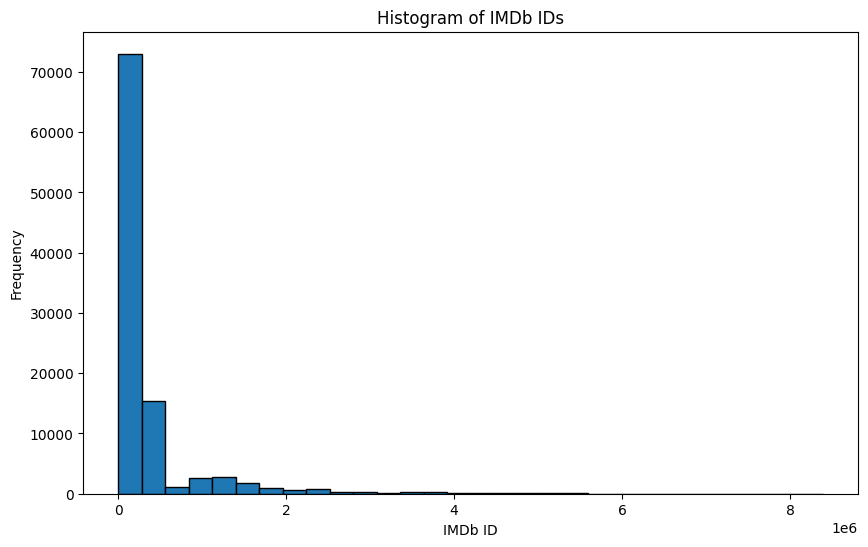

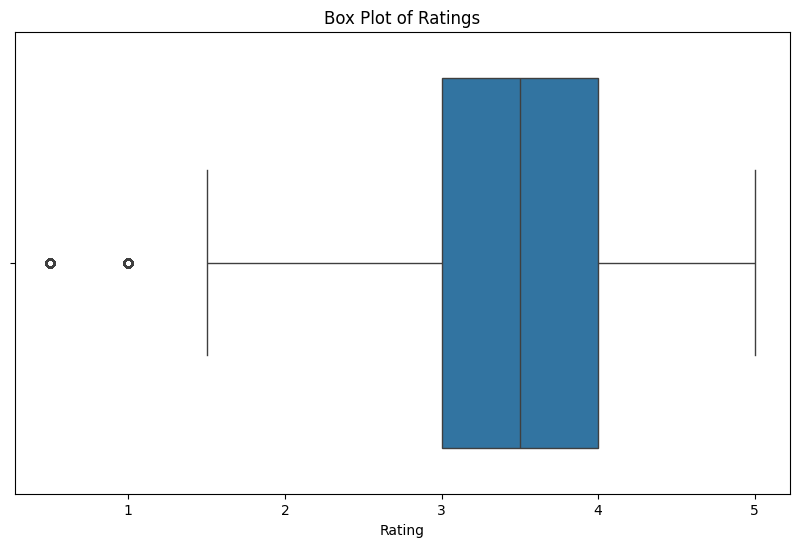

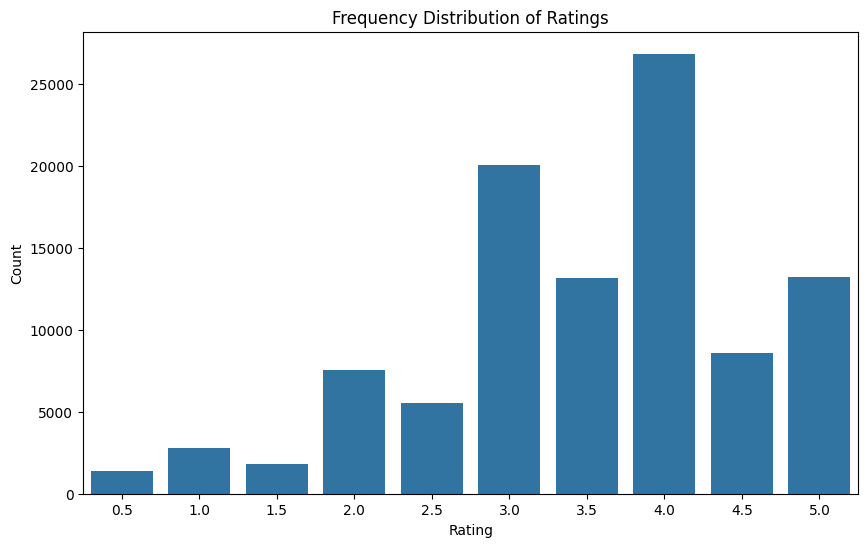

In [63]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load your data
# Assuming you have loaded your DataFrame as `df`

# Descriptive statistics
print(df.describe(include='all'))

# Histogram of IMDb IDs
plt.figure(figsize=(10, 6))
plt.hist(df['imdbId'], bins=30, edgecolor='black')
plt.title('Histogram of IMDb IDs')
plt.xlabel('IMDb ID')
plt.ylabel('Frequency')
plt.show()

# Box Plot for Ratings
plt.figure(figsize=(10, 6))
sns.boxplot(x='rating', data=df)
plt.title('Box Plot of Ratings')
plt.xlabel('Rating')
plt.show()

# Frequency distribution of Ratings
plt.figure(figsize=(10, 6))
sns.countplot(x='rating', data=df)
plt.title('Frequency Distribution of Ratings')
plt.xlabel('Rating')
plt.ylabel('Count')
plt.show()


In [64]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 100823 entries, 0 to 9741
Data columns (total 8 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   movieId    100823 non-null  int64  
 1   title      100823 non-null  object 
 2   genres     100823 non-null  object 
 3   imdbId     100823 non-null  int64  
 4   tmdbId     100823 non-null  object 
 5   userId     100823 non-null  object 
 6   rating     100823 non-null  float64
 7   timestamp  100823 non-null  float64
dtypes: float64(2), int64(2), object(4)
memory usage: 6.9+ MB


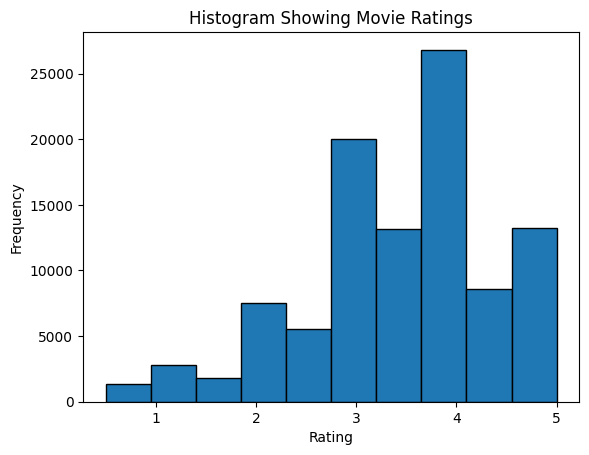

In [65]:
import matplotlib.pyplot as plt

# Extract the 'rating' column from the DataFrame
ratings = df['rating']

# Plot the histogram of ratings
plt.hist(ratings, bins=10, histtype='bar', edgecolor='black')

# Add title and labels to the plot
plt.title('Histogram Showing Movie Ratings')
plt.xlabel('Rating')
plt.ylabel('Frequency')

# Display the plot
plt.show()


The majority of ratings are clustered around the higher end of the scale, particularly around 4.0, indicating that users tend to rate movies positively. There are fewer low ratings, suggesting that either the movies are generally well-received, or users are more generous with their ratings. This kind of analysis is crucial for understanding user behavior and preferences, which is essential for building effective recommendation systems.

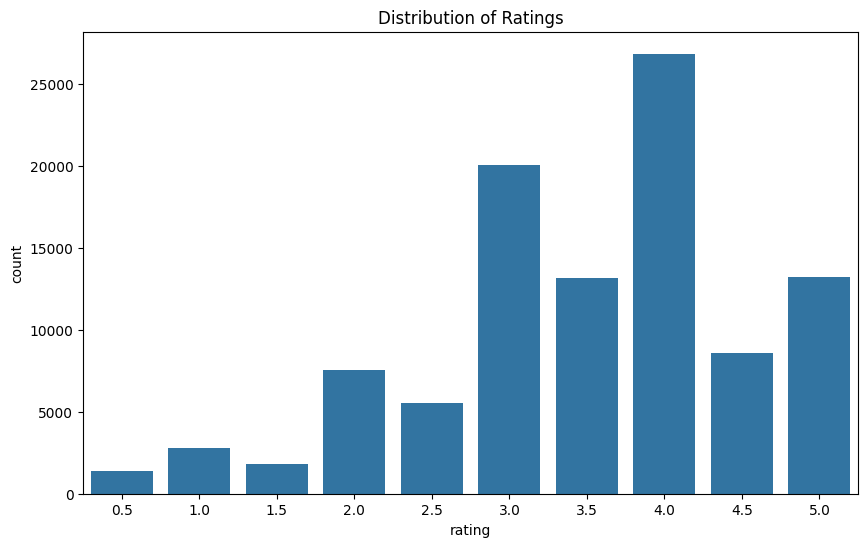

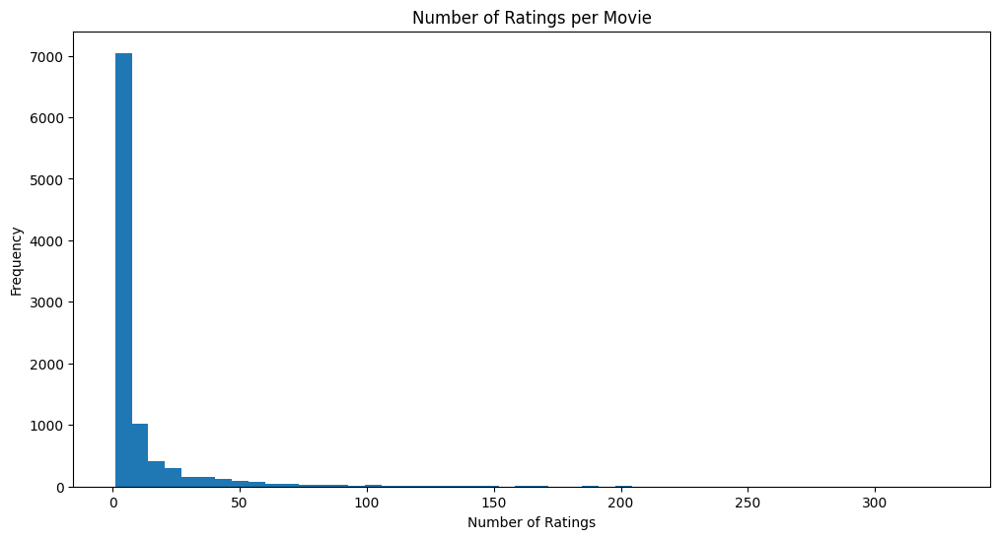

In [66]:
import matplotlib.pyplot as plt
import seaborn as sns

# Distribution of ratings
plt.figure(figsize=(10, 6))
sns.countplot(x='rating', data=df)
plt.title('Distribution of Ratings')
plt.show()

# Number of ratings per movie
ratings_per_movie = df.groupby('movieId')['rating'].count().reset_index()
plt.figure(figsize=(12, 6))
plt.hist(ratings_per_movie['rating'], bins=50)
plt.title('Number of Ratings per Movie')
plt.xlabel('Number of Ratings')
plt.ylabel('Frequency')
plt.show()


### Bivariate

In [67]:
#

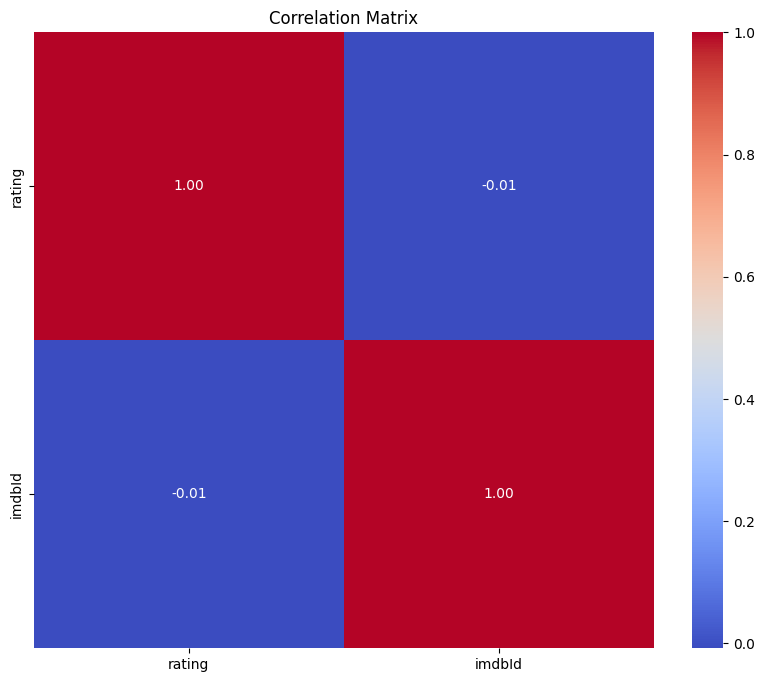

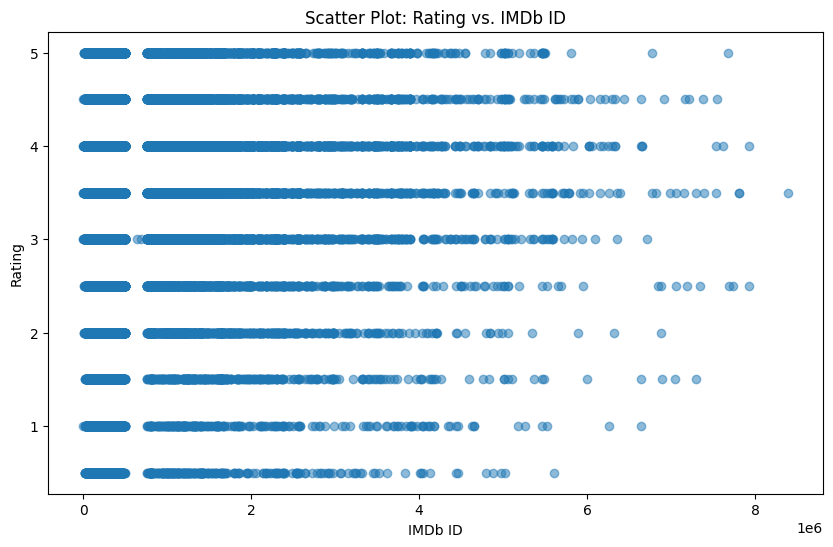

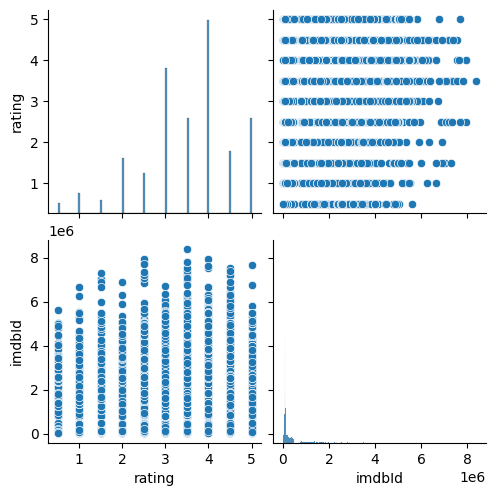

In [68]:
# Correlation matrix
plt.figure(figsize=(10, 8))
correlation_matrix = df[['rating', 'imdbId']].corr()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Matrix')
plt.show()

# Scatter Plot: Rating vs. IMDb ID
plt.figure(figsize=(10, 6))
plt.scatter(df['imdbId'], df['rating'], alpha=0.5)
plt.title('Scatter Plot: Rating vs. IMDb ID')
plt.xlabel('IMDb ID')
plt.ylabel('Rating')
plt.show()



# Pair Plot
sns.pairplot(df[['rating', 'imdbId']])
plt.show()


The histogram provides a visual representation of the distribution of movie genres based on their frequency. From the graph, we can observe the following:

Dominant Genres:

Drama: The histogram reveals that the genre "Drama" has the highest frequency, indicating that it is the most common genre among the movies in the dataset.
Comedy: Following "Drama," the genre "Comedy" also shows a high frequency, suggesting that it is another prevalent genre.
Genre Distribution:

The histogram highlights the relative popularity of different genres. By examining the bars, we can identify which genres are more common and which are less frequent.
Genres with higher bars represent those with more occurrences in the dataset, whereas genres with lower bars are less frequent.
Genre Trends:

Other Genres: Genres such as "Action," "Adventure," and "Thriller" appear with moderate frequencies, indicating their moderate presence in the dataset.
Less Frequent Genres: Some genres may have very low frequencies, showing that they are less common among the movies.
Comparative Analysis:

The comparison between "Drama" and "Comedy" illustrates their prominence compared to other genres. This can help in understanding audience preferences or trends in movie production.
In summary, the histogram allows us to quickly assess the popularity and distribution of movie genres, providing insights into which genres are more prevalent and how they compare with each other in terms of frequency.

C:\Users\Alus\AppData\Local\Temp\ipykernel_19352\2708379592.py:10: FutureWarning:

'M' is deprecated and will be removed in a future version, please use 'ME' instead.



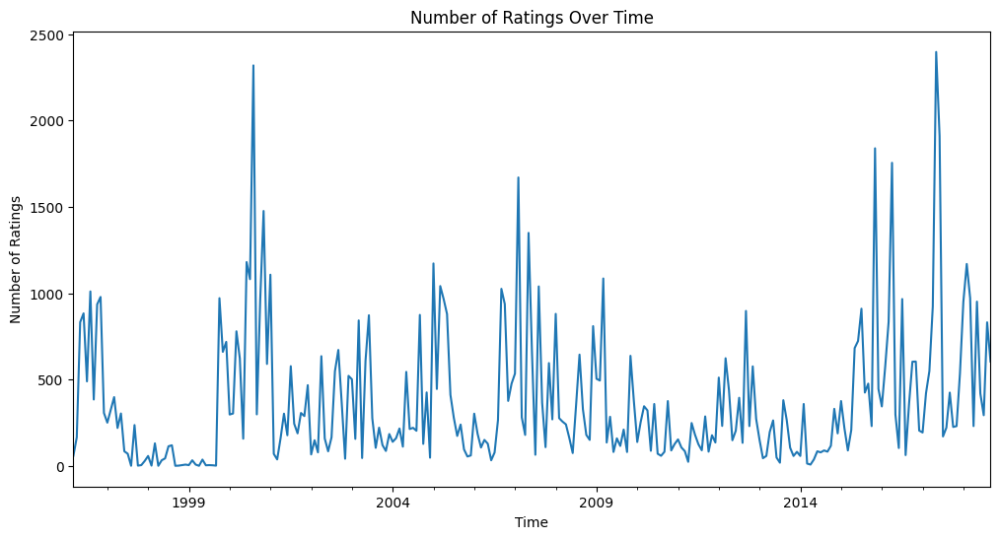

In [69]:
import datetime

ratings = data["ratings"]

# Convert timestamp to datetime
ratings['timestamp'] = pd.to_datetime(ratings['timestamp'], unit='s')

# Plot the number of ratings over time
plt.figure(figsize=(12, 6))
ratings.set_index('timestamp').resample('M').size().plot()
plt.title('Number of Ratings Over Time')
plt.xlabel('Time')
plt.ylabel('Number of Ratings')
plt.show()

In [70]:
!pip install wordcloud


[notice] A new release of pip is available: 24.1.2 -> 24.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [71]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import numpy as np
from PIL import Image
from io import BytesIO

# Generate a word cloud for movie genres with a custom colormap
genre_wordcloud = WordCloud(width=800, height=400, background_color='white', colormap='viridis').generate(' '.join(df['genres']))

# Convert the word cloud to an image
wordcloud_image = genre_wordcloud.to_image()

# Convert the image to a format suitable for Plotly
buffer = BytesIO()
wordcloud_image.save(buffer, format='PNG')
buffer.seek(0)
image_data = buffer.getvalue()

# Create a Plotly figure
fig = go.Figure()

# Add the word cloud image to the Plotly figure
fig.add_trace(go.Image(z=np.array(Image.open(BytesIO(image_data)))))

# Update layout to remove the axes and set the title
fig.update_layout(
    title='Word Cloud for Movie Genres',
    xaxis=dict(showticklabels=False),
    yaxis=dict(showticklabels=False),
    title_x=0.5
)

# Show the interactive plot
fig.show()


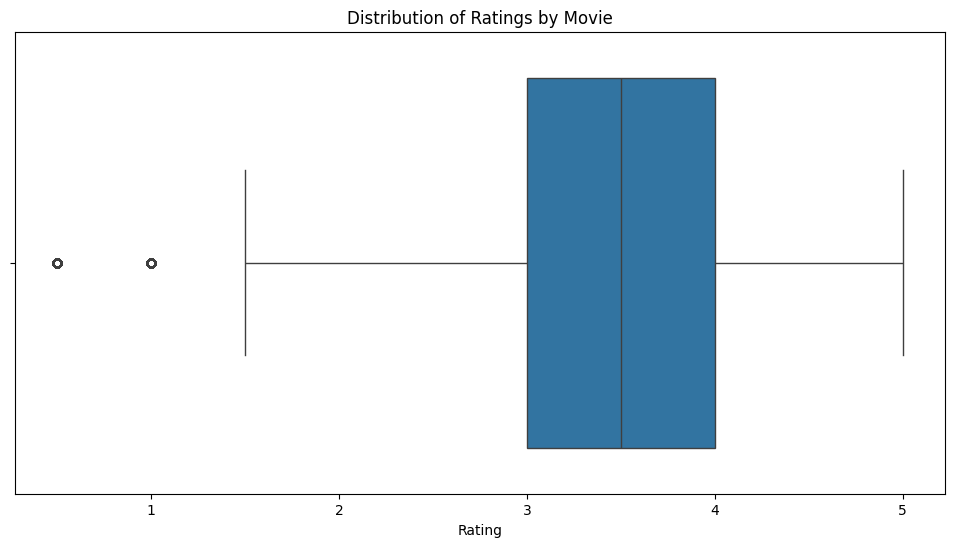

In [72]:
# Boxplot of ratings by movie
plt.figure(figsize=(12, 6))
sns.boxplot(x='rating', data=df)
plt.title('Distribution of Ratings by Movie')
plt.xlabel('Rating')
plt.show()

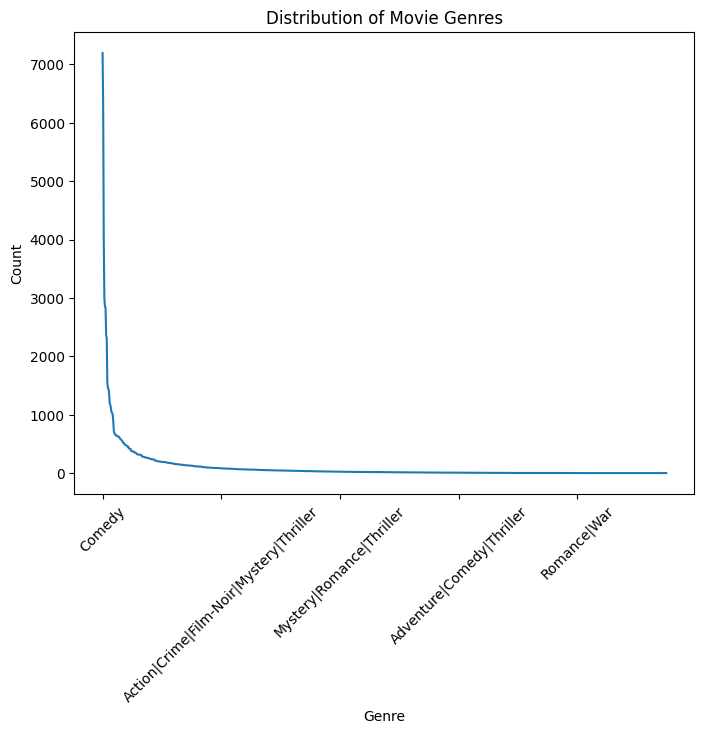

In [73]:
# Creating a lineplot of the 'genre' column

fig, ax = plt.subplots(figsize=(8,6))

genre_counts = df['genres'].value_counts()

# plot the lineplot
genre_counts.plot()

plt.xticks(rotation=45)

#Set the axis labels and title
plt.xlabel('Genre')
plt.ylabel('Count')
plt.title('Distribution of Movie Genres')

# Show the plot
plt.show();

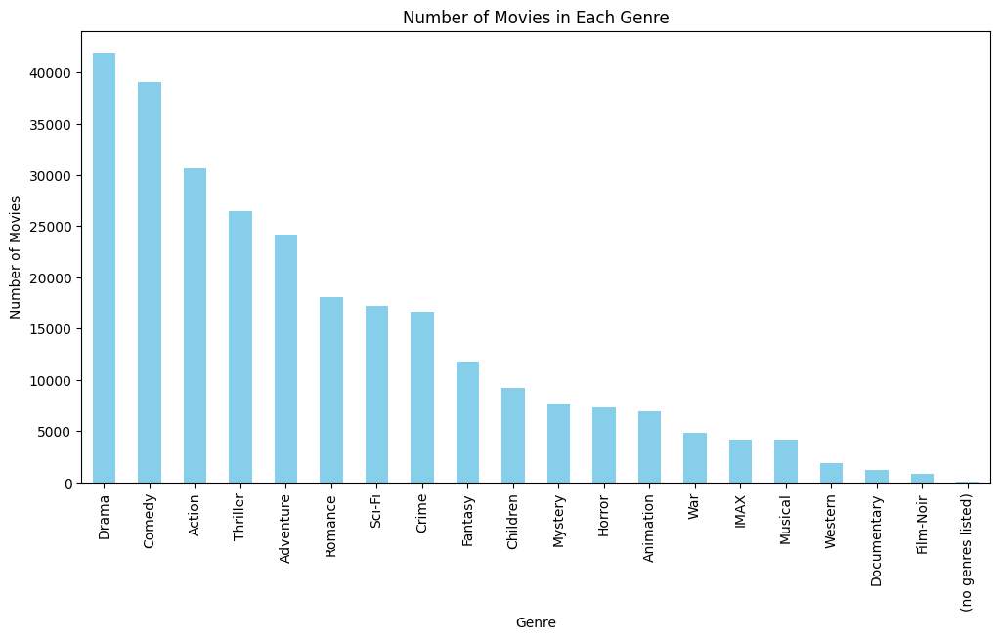

In [74]:
# count of movies in each genre
genre_counts = df['genres'].str.split('|', expand=True).stack().value_counts()
plt.figure(figsize=(12, 6))
genre_counts.plot(kind='bar', color='skyblue')
plt.title('Number of Movies in Each Genre')
plt.xlabel('Genre')
plt.ylabel('Number of Movies')
plt.show()

C:\Users\Alus\AppData\Local\Temp\ipykernel_19352\4052738780.py:5: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




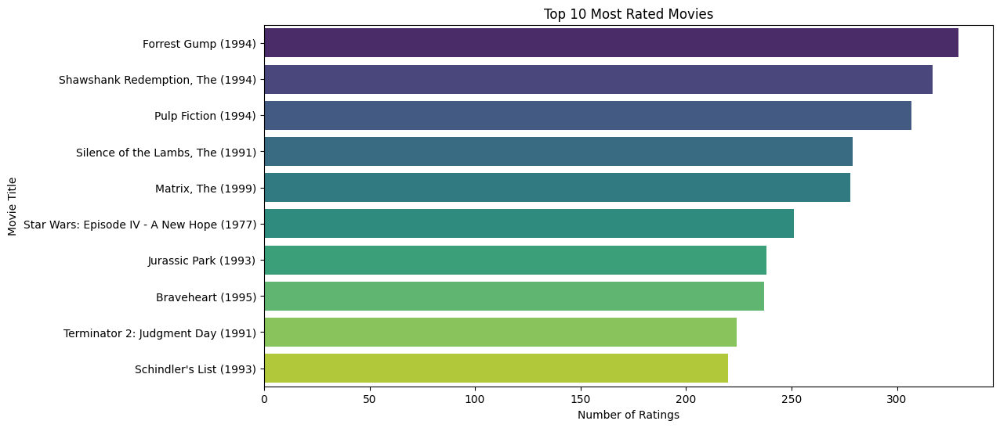

In [75]:
# top N most rated movies.
top_rated_movies = df.groupby('movieId')['rating'].count().sort_values(ascending=False).head(10)
top_rated_movies = pd.merge(top_rated_movies, df[['movieId', 'title']], on='movieId', how='left')
plt.figure(figsize=(12, 6))
sns.barplot(x='rating', y='title', data=top_rated_movies, palette='viridis')
plt.title('Top 10 Most Rated Movies')
plt.xlabel('Number of Ratings')
plt.ylabel('Movie Title')
plt.show()

## Generating the Recommender System

It's time to now come up with a recommender system, and for that there are a few choices we have as listed below:

**1. Unpersonalized:**
    - We could simply recommend the most popular movies for every use but that would throw away the desired user experience brought by a personalized system.\
**2. Personalized:**
    - This leads us to use a personalized approach in this system, and for that, we have the choices below:
```
|---> Content-based filtering
|---> Collaborative filtering
    |---> Memory/Neighbourhood based (KNN)
    |---> Model based (Matrix factorization)
        |---> Singular Value Decomposition
        |---> Alternating Least Squares

```

The goal is try out all the systems and pick out the best recommmendation system.

### Content-based filtering:

In the context of this data-set, a content-based recommendation system is one where we recommend a movie similar to one a user likes. We will use the genres for the content-based filtering which is shown below:

In [76]:
# genres in the dataframe
df["genres"]

0       Adventure|Animation|Children|Comedy|Fantasy
0       Adventure|Animation|Children|Comedy|Fantasy
0       Adventure|Animation|Children|Comedy|Fantasy
0       Adventure|Animation|Children|Comedy|Fantasy
0       Adventure|Animation|Children|Comedy|Fantasy
                           ...                     
9737                Action|Animation|Comedy|Fantasy
9738                       Animation|Comedy|Fantasy
9739                                          Drama
9740                               Action|Animation
9741                                         Comedy
Name: genres, Length: 100823, dtype: object

There is a slight problem though. After merging our dataframe with the ratings, the dataframe expanded from 9742 to 100000+ records, which will present a slight problem with computation.

In [77]:
df.shape

(100823, 8)

So this leads us to use the dataset without the ratings and tags, which we stored in a variable called __merged_movies_links__.

#### Procedure:
- We shall use the __SciKit Learn's TfidfVectorizer__, which is a class from scikit-learn, a popular machine learning library in Python, used for converting a collection of raw text documents into a matrix of TF-IDF (Term Frequency-Inverse Document Frequency) features. TF-IDF is a numerical statistic that reflects the importance of a word in a document relative to a collection of documents.
    - We shall then fit the __genres__ into the TfidfVectorizer which yields a sparse matrix.
- To compute a similarity matrix, we then use a sigmoid kernel, which computes the similarity of movies given the index.

__Note__: As a safety measure, we fill in any NaN values with an empty text to enable the machine learning algorithm to work well

In [78]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import sigmoid_kernel

# Initialize the TF-IDF Vectorizer with specific parameters
tfv = TfidfVectorizer(
    min_df=3,  # Minimum document frequency
    max_features=None,  # No limit on the number of features
    strip_accents='unicode',  # Remove accents from characters
    analyzer='word',  # Analyze by words
    token_pattern=r'\w{1,}',  # Token pattern for extracting words
    ngram_range=(1, 3),  # Create 1-grams to 3-grams
    stop_words='english'  # Remove common English stop words
)

# Fill NaN values in the 'genres' column with empty strings
merged_movies_links['genres'] = merged_movies_links['genres'].fillna('')

# Replace '|' with ', ' in the 'genres' column to standardize the format
merged_movies_links['genres'] = merged_movies_links['genres'].map(lambda x: ", ".join(x.split("|")))

# Display the first few rows of the 'genres' column after processing
merged_movies_links['genres'].head()


0    Adventure, Animation, Children, Comedy, Fantasy
1                       Adventure, Children, Fantasy
2                                    Comedy, Romance
3                             Comedy, Drama, Romance
4                                             Comedy
Name: genres, dtype: object

In [79]:
tfv_matrix = tfv.fit_transform(merged_movies_links['genres'])
tfv_matrix

<9742x402 sparse matrix of type '<class 'numpy.float64'>'
	with 42867 stored elements in Compressed Sparse Row format>

In [80]:
# Compute the sigmoid kernel
sig = sigmoid_kernel(tfv_matrix, tfv_matrix)

In [81]:
print("length of the similarity matrix:", len(sig))
print(sig[0])

length of the similarity matrix: 9742
[0.76263689 0.76180765 0.76164424 ... 0.76159416 0.76172628 0.76173151]


We create a reverse map of the movies titles, which helps us get a movie index just by the name as shown:

In [82]:
# reverse mapping of indices and movie titles
indices = pd.Series(merged_movies_links.index, index=merged_movies_links['title']).drop_duplicates()
indices

title
Toy Story (1995)                                0
Jumanji (1995)                                  1
Grumpier Old Men (1995)                         2
Waiting to Exhale (1995)                        3
Father of the Bride Part II (1995)              4
                                             ... 
Black Butler: Book of the Atlantic (2017)    9737
No Game No Life: Zero (2017)                 9738
Flint (2017)                                 9739
Bungo Stray Dogs: Dead Apple (2018)          9740
Andrew Dice Clay: Dice Rules (1991)          9741
Length: 9742, dtype: int64

In [83]:
# test
indices['No Game No Life: Zero (2017)']

9738

In [84]:
list(enumerate(sig[indices['Toy Story (1995)']]))[:5]

[(0, 0.7626368906233343),
 (1, 0.7618076535093508),
 (2, 0.7616442356858768),
 (3, 0.7616291558555321),
 (4, 0.7617315097208257)]

In [85]:
def get_title(text, df=df):
    """Gets the movie title matching the provided text and its genres.

    Args:
        text (str): The text to search for in the movie titles.
        df (pd.DataFrame): The DataFrame containing movie data (default is the global `df`).

    Returns:
        tuple: A tuple containing:
            - title (str): The title of the movie matching the input text, or None if no match is found.
            - genres (str): The genres of the matching movie, or None if no match is found.
    """
    # Create a boolean mask to filter movies with titles containing the input text (case-insensitive)
    mask = df['title'].str.contains(text, case=False, regex=False)
    
    # Get the title of the first matching movie if any match is found
    title = df.loc[mask, 'title'].head(1).values[0] if any(mask) else None
    
    # If no matching title is found, print a message and return None for both title and genres
    if not title:
        print(f"\n'{text}' does not match any movies. Please try again")
        return None, None

    # Return the title and genres of the matching movie
    return title, df.loc[mask].head(1)["genres"].values[0]


In [86]:
# test
print(get_title("Superman (1978)", df))
print()
print(get_title("NibK7Iv", df))

('Superman (1978)', 'Action|Adventure|Sci-Fi')


'NibK7Iv' does not match any movies. Please try again
(None, None)


In [87]:
def give_rec(title, sig=sig):
    """Get the index corresponding to title"""
    try:
        # get title
        title, genres = get_title(title, merged_movies_links)
        
        # print the movie title matching the text
        if title:
            print(f"Recommendation for {title}")
            print("Genres: ", genres)
        
        idx = indices[title]
        
        # Get the pairwsie similarity scores 
        sig_scores = list(enumerate(sig[idx]))

        # Sort the movies 
        sig_scores = sorted(sig_scores, key=lambda x: x[1], reverse=True)

        # Scores of the 10 most similar movies
        sig_scores = sig_scores[1:11]

        # Movie indices
        movie_indices = [i[0] for i in sig_scores]

        # Top 10 most similar movies
        return merged_movies_links.iloc[movie_indices].drop_duplicates()
    except Exception as _:
        print(_)
        return "⚠ Oops! Something went wrong!"
    
    
    
# test
give_rec('superman')

Recommendation for Superman (1978)
Genres:  Action, Adventure, Sci-Fi


,movieId,title,genres,imdbId,tmdbId
224,260,Star Wars: Episode IV - A New Hope (1977),"Action, Adventure, Sci-Fi",76759,11.0
275,316,Stargate (1994),"Action, Adventure, Sci-Fi",111282,2164.0
385,442,Demolition Man (1993),"Action, Adventure, Sci-Fi",106697,9739.0
898,1196,Star Wars: Episode V - The Empire Strikes Back...,"Action, Adventure, Sci-Fi",80684,1891.0
911,1210,Star Wars: Episode VI - Return of the Jedi (1983),"Action, Adventure, Sci-Fi",86190,1892.0
1058,1375,Star Trek III: The Search for Spock (1984),"Action, Adventure, Sci-Fi",88170,157.0
1346,1831,Lost in Space (1998),"Action, Adventure, Sci-Fi",120738,2157.0
1557,2094,"Rocketeer, The (1991)","Action, Adventure, Sci-Fi",102803,10249.0
1567,2105,Tron (1982),"Action, Adventure, Sci-Fi",84827,97.0
1692,2275,Six-String Samurai (1998),"Action, Adventure, Sci-Fi",118736,24746.0


In [88]:
give_rec("Tron (1982)")

Recommendation for Tron (1982)
Genres:  Action, Adventure, Sci-Fi


,movieId,title,genres,imdbId,tmdbId
224,260,Star Wars: Episode IV - A New Hope (1977),"Action, Adventure, Sci-Fi",76759,11.0
275,316,Stargate (1994),"Action, Adventure, Sci-Fi",111282,2164.0
385,442,Demolition Man (1993),"Action, Adventure, Sci-Fi",106697,9739.0
898,1196,Star Wars: Episode V - The Empire Strikes Back...,"Action, Adventure, Sci-Fi",80684,1891.0
911,1210,Star Wars: Episode VI - Return of the Jedi (1983),"Action, Adventure, Sci-Fi",86190,1892.0
1058,1375,Star Trek III: The Search for Spock (1984),"Action, Adventure, Sci-Fi",88170,157.0
1346,1831,Lost in Space (1998),"Action, Adventure, Sci-Fi",120738,2157.0
1557,2094,"Rocketeer, The (1991)","Action, Adventure, Sci-Fi",102803,10249.0
1567,2105,Tron (1982),"Action, Adventure, Sci-Fi",84827,97.0
1692,2275,Six-String Samurai (1998),"Action, Adventure, Sci-Fi",118736,24746.0


#### Summary of the output:
As we can see, the system works for the most part, but it inherently has a few issues:
- It only recommends by genre, which is shallow and insufficient, as it doesn't scoop out the patterns deeply embedded in our dataset.
- Ratings, which are a high indicator of preference aren't used, so the system is to a degree, not as effective.
- Finally, as demonstrated above, the recommendation is somewhat 'rigid', meaning, if a movie's genre is Action, Adventure and Sci-fi, then one can only get a movie with the same exact genres. 

For a more flexible system which goes deeper into the data-set, we have to use a collaborative filtering approach.

### Collaborative filtering
Collaborative filtering can be user-based or item-based. User-based collaborative filtering recommends items based on the preferences of users with similar tastes, while item-based collaborative filtering recommends items similar to those the user has liked.
#### Memory/ Neighbourhood based:
- For this, we first create a pivot table, from which we'll derive our sparse matrix: 

In [123]:
## First lets create a Pivot matrix
knnrc_df=df.pivot_table(index='title',columns='userId',values='rating').fillna(0)
knnrc_df.head()

userId,1.0,2.0,3.0,4.0,5.0,6.0,7.0,8.0,9.0,10.0,...,601.0,602.0,603.0,604.0,605.0,606.0,607.0,608.0,609.0,610.0
title,,,,,,,,,,,,,,,,,,,,,
'71 (2014),0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0
'Hellboy': The Seeds of Creation (2004),0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
'Round Midnight (1986),0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
'Salem's Lot (2004),0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
'Til There Was You (1997),0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [90]:
knnrc_df.shape

(9713, 610)

In [91]:
from scipy.sparse import csr_matrix
from sklearn.neighbors import NearestNeighbors

movie_features_df_matrix = csr_matrix(knnrc_df.values)

model_knn = NearestNeighbors(metric = 'cosine', algorithm = 'brute')
model_knn.fit(movie_features_df_matrix)

NearestNeighbors(algorithm='brute', metric='cosine')

In [125]:
# reverse map using the pivot matrix
new_indices = {value: index for index, value in enumerate(knnrc_df.index)}

In [129]:
# test
query_index = new_indices['RoboCop (1987)']
distances, indices = model_knn.kneighbors(knnrc_df.iloc[query_index,:].values.reshape(1, -1), n_neighbors = 6)


for i in range(0, len(distances.flatten())):
    if i == 0:
        print('Recommendations for {0}:\n'.format(knnrc_df.index[query_index]))
    else:
        print('{0}: {1}, with distance of {2}:'.format(i, knnrc_df.index[indices.flatten()[i]], distances.flatten()[i]))

Recommendations for RoboCop (1987):

1: Total Recall (1990), with distance of 0.334274954513743:
2: Lethal Weapon (1987), with distance of 0.3374175486826607:
3: Terminator, The (1984), with distance of 0.3595445115903788:
4: Superman (1978), with distance of 0.3711941943447822:
5: Predator (1987), with distance of 0.37956829381477153:


Let's now use __surprise__ library aso as to be able to validate our models:

In [131]:
from surprise import Dataset, Reader
from surprise.model_selection import train_test_split
from surprise import accuracy
from surprise.prediction_algorithms import KNNWithMeans, KNNBasic, KNNBaseline
from surprise.prediction_algorithms import SVD
from surprise.model_selection import GridSearchCV, cross_validate

reader = Reader(rating_scale=(1, 5))

expected_column_names = ["userId", "movieId", "rating"]

# Load the data into a Surprise Dataset
data_surp = Dataset.load_from_df(df[expected_column_names], reader)

In [132]:
# cross validating with KNNBasic
knn_basic = KNNBasic(sim_options={'name':'pearson', 'user_based':True})
cv_knn_basic = cross_validate(knn_basic, data_surp, n_jobs=-1)


# cross validating with KNNBaseline
knn_baseline = KNNBaseline(sim_options={'name':'pearson', 'user_based':True})
cv_knn_baseline = cross_validate(knn_baseline, data_surp)


Estimating biases using als...
Computing the pearson similarity matrix...
Done computing similarity matrix.
Estimating biases using als...
Computing the pearson similarity matrix...
Done computing similarity matrix.
Estimating biases using als...
Computing the pearson similarity matrix...
Done computing similarity matrix.
Estimating biases using als...
Computing the pearson similarity matrix...
Done computing similarity matrix.
Estimating biases using als...
Computing the pearson similarity matrix...
Done computing similarity matrix.


In [133]:
for i in cv_knn_baseline.items():
    print(i)
    
print('-----------------------')
# print validation results
np.mean(cv_knn_baseline['test_rmse'])

('test_rmse', array([0.87796949, 0.87056343, 0.87863847, 0.88321221, 0.87933729]))
('test_mae', array([0.67127578, 0.66527569, 0.66946644, 0.67631652, 0.66982014]))
('fit_time', (3.552814483642578, 1.4714713096618652, 1.4236314296722412, 1.1646487712860107, 1.6257469654083252))
('test_time', (5.454339504241943, 3.88911509513855, 3.4480841159820557, 4.618807792663574, 3.2521026134490967))
-----------------------


0.8779441780658302

In [134]:
# print out the average RMSE score for the test set
for i in cv_knn_basic.items():
    print(i)
# print validation results
print('-----------------------')
print(np.mean(cv_knn_basic['test_rmse']))

('test_rmse', array([0.98230938, 0.95728505, 0.96705669, 0.97976138, 0.97341169]))
('test_mae', array([0.75686771, 0.74096738, 0.74782795, 0.75320513, 0.75440072]))
('fit_time', (1.5075831413269043, 1.6695115566253662, 1.7699363231658936, 2.2041831016540527, 1.8884329795837402))
('test_time', (6.109088182449341, 5.988459825515747, 5.873333215713501, 5.733104228973389, 7.233527421951294))
-----------------------
0.9719648342944577


**Summary of Surprise lib's KNN:**
- The KNN Basic and KNN Baseline models exhibit similar RMSE, with the KNN Baseline slightly outperforming the KNN Basic model.
- Both KNN models have relatively low MAE, indicating good accuracy in predicting user ratings.
- The training time for the KNN models is relatively short, making them efficient for training.
- The SVD model has a slightly higher RMSE compared to the KNN models, but its overall performance is still competitive.

The choice between these models depends on specific use-case requirements, including the trade-off between accuracy and computational efficiency. Further analysis and potential hyperparameter tuning could refine the performance of these models.

Let's make a function to test out the KNN method

In [139]:
def knn_get_rec(title, rec=6, verbose=True):
    """Get recommendations for a movie using KNN
    """
    # create a return dataframe
    ret_df = pd.DataFrame()
    # initiate an empty list to fill the knn distances
    dists = []
    try:
        # get movie details and the pivot matrix index
        title, genres = get_title(title, df)
        idx = new_indices[title]
        
        # compute the knn distance and index
        distances, knn_indices = model_knn.kneighbors(knnrc_df.iloc[idx,:].values.reshape(1, -1), n_neighbors = rec + 1)

        if title and verbose:
            print(f'Recommendations for {title}:')
            print(f"Genres: {', '.join(genres.split('|'))}")

        for i in range(0, len(distances.flatten())):
            if i == 0:
                continue
            rec_movie = knnrc_df.index[knn_indices.flatten()[i]]
            movies_df = data['movies']
            mask = movies_df['title'].str.contains(rec_movie, case=False, regex=False)
            
            # fill in return dataframe
            ret_df = pd.concat([ret_df, movies_df[mask]])
            
            # fill in the knn distances in the df
            dists.append(distances.flatten()[i])

        ret_df["knn_distance"] = dists

        return ret_df

    except Exception as _:
        return "⚠ Oops! Something went wrong!"
        

# test
knn_get_rec('RoboCop (1987)', 10)

Recommendations for RoboCop (1987):
Genres: Action, Crime, Drama, Sci-Fi, Thriller


'⚠ Oops! Something went wrong!'

In [140]:
# test 2
knn_get_rec('Stargate', 10)

Recommendations for Stargate (1994):
Genres: Action, Adventure, Sci-Fi


'⚠ Oops! Something went wrong!'

#### Sumarry of the Neighbourhood based collaborative approach (SciKit's):
- This model works better than the content-based approach as it makes use of the user ratings, thereby reading more into the dataset.
    - However, neighbourhood-based collaborative filtering has some limitations, particularly in scenarios with sparse data, the cold start problem for new users or items, and scalability issues as the dataset grows. Therefore, it becomes essential to explore model-based approaches like Singular Value Decomposition (SVD) or Alternating Least Squares (ALS).



In [141]:
def surp_knn_get_rec(uid=1000, rec_count=10):
    # Load the dataset and create a train-test split
    reader = Reader(rating_scale=(1, 5))
    data_ = Dataset.load_from_df(df[expected_column_names], reader)
    trainset, _ = train_test_split(data_, test_size=0.2, random_state=42)

    # Train the KNN model
    sim_options = {'name': 'pearson', 'user_based': True}
    knn_model = KNNBasic(sim_options=sim_options)
    knn_model.fit(trainset)

    # Get the user's unrated items
    unrated_items = [item for item in trainset.all_items() if item not in trainset.ur[uid]]

    # Predict ratings for unrated items
    predictions = [knn_model.predict(uid, iid) for iid in unrated_items]

    # Sort the predictions by estimated rating in descending order
    sorted_predictions = sorted(predictions, key=lambda x: x.est, reverse=True)

    # Extract the top N recommended items
    top_recommendations = sorted_predictions[:rec_count]

    # Print or return the recommended items
    recommended_movie_ids = [prediction.iid for prediction in top_recommendations]
    movie_df = data['movies']
    recommended_movies = movie_df[movie_df['movieId'].isin(recommended_movie_ids)]

    return recommended_movies

# test
surp_knn_get_rec(uid=100, rec_count=10)

Computing the pearson similarity matrix...
Done computing similarity matrix.


TypeError: 'DatasetAutoFolds' object is not subscriptable

In [101]:
# test 2
surp_knn_get_rec(uid=300, rec_count=5)

Computing the pearson similarity matrix...
Done computing similarity matrix.


,movieId,title,genres
48,53,Lamerica (1994),Adventure|Drama
202,236,French Kiss (1995),Action|Comedy|Romance
245,283,New Jersey Drive (1995),Crime|Drama
292,334,Vanya on 42nd Street (1994),Drama
450,515,"Remains of the Day, The (1993)",Drama|Romance


### Model-Based Methods - Matrix Factorization using SVD:

Let's try out a matric factorization technique on the data, by singular value decomposition:

In [108]:
param_grid = {'n_factors':[20, 100],'n_epochs': [5, 10], 'lr_all': [0.002, 0.005],
              'reg_all': [0.4, 0.6]}

gs_model = GridSearchCV(SVD, param_grid=param_grid, n_jobs = -1, joblib_verbose=5)

gs_model.fit(data_surp)

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:    9.7s
[Parallel(n_jobs=-1)]: Done  64 tasks      | elapsed:   32.5s
[Parallel(n_jobs=-1)]: Done  80 out of  80 | elapsed:   41.3s finished


In [109]:
best_params = gs_model.best_params["rmse"]

In [110]:
trainset, testset = train_test_split(data_surp, test_size=0.2)

svd = SVD(**best_params)
svd.fit(trainset)
predictions = svd.test(testset)
print(accuracy.rmse(predictions))

RMSE: 0.8928
0.8927546232710517


A value of 0.8925 suggests that, on average, the predicted ratings deviate by approximately 0.8925 from the true ratings. Lower RMSE values indicate better predictive accuracy.

In [113]:
# test
svd.predict(uid="230", iid=23)

Prediction(uid='230', iid=23, r_ui=None, est=3.4093948108719427, details={'was_impossible': False})

In [122]:
def svd_get_rec(uid=1000, rec_count=0):
    """Returns top 10 movies using SVD
    Parameters:
    ===========
    uid - user id
    rec_count - movie recommendation count
    """
    trainset, testset = train_test_split(data_surp, test_size=0.2)
    # Get the user's unrated items
    unrated_items = [item for item in trainset.all_items() if item not in trainset.ur[uid]]

    # Predict ratings for unrated items
    predictions = [svd.predict(uid, iid) for iid in unrated_items]

    # Sort the predictions by estimated rating in descending order
    sorted_predictions = sorted(predictions, key=lambda x: x.est, reverse=True)

    # Extract the top N recommended items
    top_recommendations = sorted_predictions[:rec_count]

    # Print or return the recommended items
    recommended_movie_ids = [prediction.iid for prediction in top_recommendations]
    movie_df = data['title']
    recommended_movies = movie_df[movie_df['movieId'].isin(recommended_movie_ids)]

    return recommended_movies

# test
svd_get_rec(uid=100, rec_count=10)

TypeError: 'DatasetAutoFolds' object is not subscriptable

### Summary of the models:


## Final Recommender System:

For the final recommender system, we decided to go with SciKit Learn's  recommender system (which is a neighbourhood based (KNN) system). 
> The main reason for this is because, it is easy to test out an item-item based movie system more than a user-user, after running the recommender functions, because the items are familiar more than the users.


#### How the final system works:
1. take in a user id.
2. randomly select movies they highly rated.
3. return 10 recommendations based on the movies liked.
4. If no id given, use the unpersonalized recommender.

In [117]:
def top_ten_highly_rated(uid, rec=10):
    """Returns a list of movies highly rated by a user.

    Args:
        uid (int): The user ID for which to find highly rated movies.
        rec (int): The number of top-rated movies to return (default is 10).

    Returns:
        list: A list of movie titles highly rated by the user.

    Raises:
        ValueError: If the user ID does not exist or has no ratings.
    """
    # Create a boolean mask to filter ratings for the given user ID
    mask = data["ratings"]['userId'] == uid
    
    # Get the user's movies and sort by rating in descending order, then take the top 'rec' movies
    user_movies = data["ratings"][mask].sort_values(by=['rating'], ascending=False).head(rec)
    
    # Merge the top-rated movies with movie details from the 'movies' DataFrame
    user_movies = pd.merge(data["movies"], user_movies, how="inner", on="movieId")
    
    # Check if the user has rated any movies
    if len(user_movies) < 1:
        raise ValueError(f"User denoted by id: '{uid}' does not exist or has no ratings!")
    
    # Return a list of movie titles
    return list(user_movies["title"])

# Test the function for user ID 100
top_ten_highly_rated(100)


TypeError: 'DatasetAutoFolds' object is not subscriptable

In [118]:
def unpersonalized_recomm(count=10):
    """Returns a randomlist of highly ranked movies movies"""
    unique_genres = list(set(df['genres'].str.split('|', expand=True).stack()))
    
    recomms = pd.DataFrame()
    for genre in unique_genres:
        # select top 5 of each genre
        mask = df["genres"].str.contains(genre, regex=False, case=False)
        top_5 = df[mask].sort_values(by="rating", ascending=False).head()
        top_5["year_of_release"] = top_5["title"].map(lambda x: x[-5:].strip(")"))        
        recomms = pd.concat([recomms, top_5])
    
    # return shuffled
    print("Unpersonalized recommendation:")
    return recomms.sample(frac=1).drop_duplicates().head(count)

# test
unpersonalized_recomm()

Unpersonalized recommendation:


,movieId,title,genres,imdbId,tmdbId,userId,rating,timestamp,year_of_release
581,714,Dead Man (1995),Drama|Mystery|Western,112817,922.0,171.0,5.0,8.669045e+08,1995
1923,2551,Dead Ringers (1988),Drama|Horror|Thriller,94964,9540.0,603.0,5.0,9.539279e+08,1988
3061,4105,"Evil Dead, The (1981)",Fantasy|Horror|Thriller,83907,764.0,380.0,5.0,1.494804e+09,1981
3194,4306,Shrek (2001),Adventure|Animation|Children|Comedy|Fantasy|Ro...,126029,808.0,359.0,5.0,1.198112e+09,2001
21,22,Copycat (1995),Crime|Drama|Horror|Mystery|Thriller,112722,1710.0,6.0,5.0,8.455539e+08,1995
709,928,Rebecca (1940),Drama|Mystery|Romance|Thriller,32976,223.0,59.0,5.0,9.536104e+08,1940
964,1265,Groundhog Day (1993),Comedy|Fantasy|Romance,107048,137.0,151.0,5.0,8.559488e+08,1993
2355,3114,Toy Story 2 (1999),Adventure|Animation|Children|Comedy|Fantasy,120363,863.0,591.0,5.0,9.705252e+08,1999
712,931,Spellbound (1945),Mystery|Romance|Thriller,38109,4174.0,603.0,5.0,9.544824e+08,1945
701,919,"Wizard of Oz, The (1939)",Adventure|Children|Fantasy|Musical,32138,630.0,554.0,5.0,9.449018e+08,1939


In [119]:
import random

random.seed(555)

def final_recommender(uid=None, rec=10):
    """Get recommendations for a movie using KNN
    params:
    =======
    uid - user id
    rec - recommendation movie count
    """
    if not uid:
        return unpersonalized_recomm(rec)
    # create a return dataframe
    ret_df = pd.DataFrame()
    # initiate an empty list to fill the knn distances
    try:
        # get top 10 movies
        top_user_movies = top_ten_highly_rated(uid, rec)
        
        for i in range(rec):
            # random title from top 10 movies highly ranked by user
            random_title = top_user_movies[random.randint(0, 5)]
            
            # get the full title
            title, _ = get_title(random_title, df)
            
            # get recommendation of random title
            movie_rec = knn_get_rec(title, rec, verbose=False)
            
            # if not dataframe continue
            if type(movie_rec) is str:
                continue
            # sort by distance (ascending)
            ret_df = movie_rec.sort_values(by="knn_distance")

            # fill in the return df
            ret_df = pd.concat([ret_df, ret_df.head()])
                
            # drop dups
            ret_df = ret_df.drop_duplicates()

        print(f"Recommendation for user id: {uid}")
        return ret_df

    except Exception as _:
        print(_)
        return "⚠ Oops! Something went wrong!"
        

# test for user-id: 100
final_recommender(100, 5)

'DatasetAutoFolds' object is not subscriptable


'⚠ Oops! Something went wrong!'

In [ ]:
# test 2 for user-id: 300
final_recommender(300, 10)

Recommendation for user id: 300


,movieId,title,genres,knn_distance
3141,4226,Memento (2000),Mystery|Thriller,0.385666
4615,6874,Kill Bill: Vol. 1 (2003),Action|Crime|Thriller,0.390157
2226,2959,Fight Club (1999),Action|Crime|Drama|Thriller,0.395659
3562,4878,Donnie Darko (2001),Drama|Mystery|Sci-Fi|Thriller,0.399661
3622,4973,"Amelie (Fabuleux destin d'Amélie Poulain, Le) ...",Comedy|Romance,0.411765
4935,7438,Kill Bill: Vol. 2 (2004),Action|Drama|Thriller,0.429963
4529,6711,Lost in Translation (2003),Comedy|Drama|Romance,0.442094
2945,3949,Requiem for a Dream (2000),Drama,0.463620
4800,7153,"Lord of the Rings: The Return of the King, The...",Action|Adventure|Drama|Fantasy,0.467072
4159,5989,Catch Me If You Can (2002),Crime|Drama,0.467658


In [ ]:
# no user-id: (unpersonalized)
final_recommender()

NameError: name 'final_recommender' is not defined

## Conclusion and Recommendation:



In developing a movie recommender system, we explored various approaches including content-based filtering, neighborhood-based collaborative filtering (KNN), and model-based collaborative filtering (SVD). Each approach had its strengths and limitations.

- **Content-Based Filtering:** Utilizing movie features such as genres, we built a content-based recommender. While it provided recommendations based on similarities in content, it might face challenges in capturing diverse user preferences.

- **Neighborhood-Based Collaborative Filtering (KNN):** The KNN model, implemented using SciKit Learn, proved effective in leveraging user-item interactions to make recommendations. The item-based variant, focusing on cosine similarity, demonstrated good performance in finding similar movies.

- **Model-Based Collaborative Filtering (SVD):** We explored the Surprise library to implement SVD, a matrix factorization technique. While SVD showed reasonable performance with an RMSE of 0.8925, its effectiveness could be influenced by hyperparameter tuning.

**Recommendation:**

- Considering the trade-offs between different approaches, we recommend a hybrid model that combines the strengths of content-based filtering and collaborative filtering. This hybrid approach can leverage the detailed user-item interactions captured by collaborative filtering while incorporating content features for a more personalized and diverse recommendation.

- Additionally, further hyperparameter tuning and model evaluation, especially with a larger dataset, could enhance the performance of collaborative filtering techniques. Regular updates to the recommendation engine based on user feedback and evolving content can also contribute to its effectiveness over time.

- In conclusion, the choice of a recommender system depends on the specific requirements, user preferences, and the nature of the dataset. A well-balanced hybrid model, continually refined and validated, holds the potential to offer robust and accurate movie recommendations.

In [ ]:
import pickle

# Save the trained KNN model to a file
with open("recom_model.pkl", 'wb') as model_file:
    pickle.dump(model_knn, model_file)

# Save the DataFrame to a pickle file
knnrc_df.to_pickle("knn_pv.pkl")


NameError: name 'model_knn' is not defined